<a href="https://colab.research.google.com/github/kellykryoung/AI_Study/blob/main/textmining/01_01_LinearRegression_ML_RealData.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# 2023.May
# Instructor: Soyeon, Lee

# 실제 데이터로 회귀분석하기

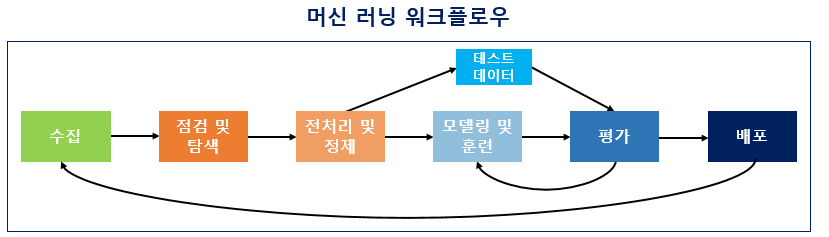

1. 데이터 수집 (Acquisition)
    - 머신 러닝을 하기 위해서는 기계에 학습시켜야 할 데이터가 필요합니다. 풀고자 하는 문제에 맞는 데이터를 다양한 형태로 수집합니다.
2. 점검 및 탐색(Inspection and exploration)
    - 데이터가 수집되었다면, 이제 데이터를 점검하고 탐색하는 단계입니다.
    - 여기서는 데이터의 구조, 노이즈 데이터, 머신 러닝 적용을 위해서 데이터를 어떻게 정제해야하는지 등을 파악해야 합니다.
    - 이 단계를 **탐색적 데이터 분석(Exploratory Data Analysis, EDA) 단계**라고도 하는데 이는 독립 변수, 종속 변수, 변수 유형, 변수의 데이터 타입 등을 점검하며 데이터의 특징과 내재하는 구조적 관계를 알아내는 과정을 의미합니다.
    - 이 과정에서 시각화와 간단한 통계 테스트를 진행하기도 합니다.
3. 전처리 및 정제(Preprocessing and Cleaning)
    - 데이터에 대한 파악이 끝났다면, 대부분의 데이터 분석가가 좋아하지 않는 과정이지만, 분석 결과/인사이트와 모델 성능에 직접적인 영향을 미치는 과정이기 때문에 중요하게 다루어지는 전처리 과정에 들어갑니다.
    - 데이터 전처리의 종류는 무수히 많지만, **대표적으로 행해지는 전처리로는 결측치 처리, 이상치 처리, 정규화, 데이터 분포 변환, 노이즈 처리 등**이 있습니다.
    - 시간과 비용, 품이 많이 드는 작업이지만 분석 결과의 80%가 전처리에 달려있다는 조사가 있을 만큼 중요한 과정입니다.
4. 모델링 및 훈련(Modeling and Training)
    - 데이터 전처리가 끝났다면, 머신 러닝에 대한 코드를 작성하는 단계인 모델링 단계에 들어갑니다.
    - 적절한 머신 러닝 알고리즘을 선택하여 모델링이 끝났다면, 전처리가 완료 된 데이터를 머신 러닝 알고리즘을 통해 기계에게 학습(training)시킵니다.
    - 이때 모든 데이터를 학습에 사용하지는 않습니다.
        - 데이터 중 일부는 테스트용으로 남겨두고 훈련용 데이터만 훈련에 사용해야 합니다. 그래야만 기계가 학습을 하고나서, 테스트용 데이터를 통해서 현재 성능이 얼마나 되는지를 측정할 수 있으며 과적합(overfitting) 상황을 막을 수 있습니다.
        - 사실 최선은 훈련용, 검증용, 테스트용. 데이터를 이렇게 세 가지로 나누고 훈련용 데이터만 훈련에 사용하는 것입니다.

5. 평가(Evaluation)
    - 기계가 다 학습이 되었다면 테스트용 데이터로 성능을 평가합니다.

6. 배포(Deployment)
    - 평가 단계에서 기계가 성공적으로 훈련이 된 것으로 판단된다면 완성된 모델이 배포되는 단계가 됩니다. 다만, 여기서 완성된 모델에 대한 전체적인 피드백으로 인해 모델을 업데이트 해야하는 상황이 온다면 수집 단계로 돌아갈 수 있습니다.

출처 : https://wikidocs.net/31947

### 1. 데이터 수집

이제부터 우리는 수입(MedInc), 주택의 건축연도(House Age), 방 개수(Averooms), 가구수, 위치 등을 바탕으로 해당 구역의 평균 집값을 예측하는 회귀 모델을 만들어야 합니다!

- Attribute Information:
    - MedInc        median income in block group
    - HouseAge      median house age in block group
    - AveRooms      average number of rooms per household
    - AveBedrms     average number of bedrooms per household
    - Population    block group population
    - AveOccup      average number of household members
    - Latitude      block group latitude
    - Longitude     block group longitude

- The target variable is the median house value for California districts, expressed in hundreds of thousands of dollars ($100,000).

In [18]:
from sklearn.datasets import fetch_california_housing
import pandas as pd
import numpy as np

# Boston 주택 가격 데이터셋 로드
housing = fetch_california_housing()



# 데이터를 Pandas DataFrame으로 변환
x_data = housing.data
y_data = housing.target
boston_df = pd.DataFrame(x_data, columns=housing.feature_names)

# 데이터프레임에 target 열 추가
boston_df['PRICE'] = y_data

# 데이터 확인
boston_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   MedInc      20640 non-null  float64
 1   HouseAge    20640 non-null  float64
 2   AveRooms    20640 non-null  float64
 3   AveBedrms   20640 non-null  float64
 4   Population  20640 non-null  float64
 5   AveOccup    20640 non-null  float64
 6   Latitude    20640 non-null  float64
 7   Longitude   20640 non-null  float64
 8   PRICE       20640 non-null  float64
dtypes: float64(9)
memory usage: 1.4 MB


- 결측치가 없고, 데이터 타입이 모두 실수형으로 추가적인 형변환도 없는 비교적 깨끗한 데이터입니다.

### 2. 점검 및 탐색(Inspection and exploration) : EDA

각 변수들의 통계데이터들을 확인해볼까요?

In [19]:
boston_df.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,PRICE
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


In [20]:
summary= boston_df.describe()
summary

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,PRICE
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,3.870671,28.639486,5.429000,1.096675,1425.476744,3.070655,35.631861,-119.569704,2.068558
std,1.899822,12.585558,2.474173,0.473911,1132.462122,10.386050,2.135952,2.003532,1.153956
min,0.499900,1.000000,0.846154,0.333333,3.000000,0.692308,32.540000,-124.350000,0.149990
25%,2.563400,18.000000,4.440716,1.006079,787.000000,2.429741,33.930000,-121.800000,1.196000
50%,3.534800,29.000000,5.229129,1.048780,1166.000000,2.818116,34.260000,-118.490000,1.797000
75%,4.743250,37.000000,6.052381,1.099526,1725.000000,3.282261,37.710000,-118.010000,2.647250
max,15.000100,52.000000,141.909091,34.066667,35682.000000,1243.333333,41.950000,-114.310000,5.000010


* 각 변수들의 히스토그램을 그려봅시다.



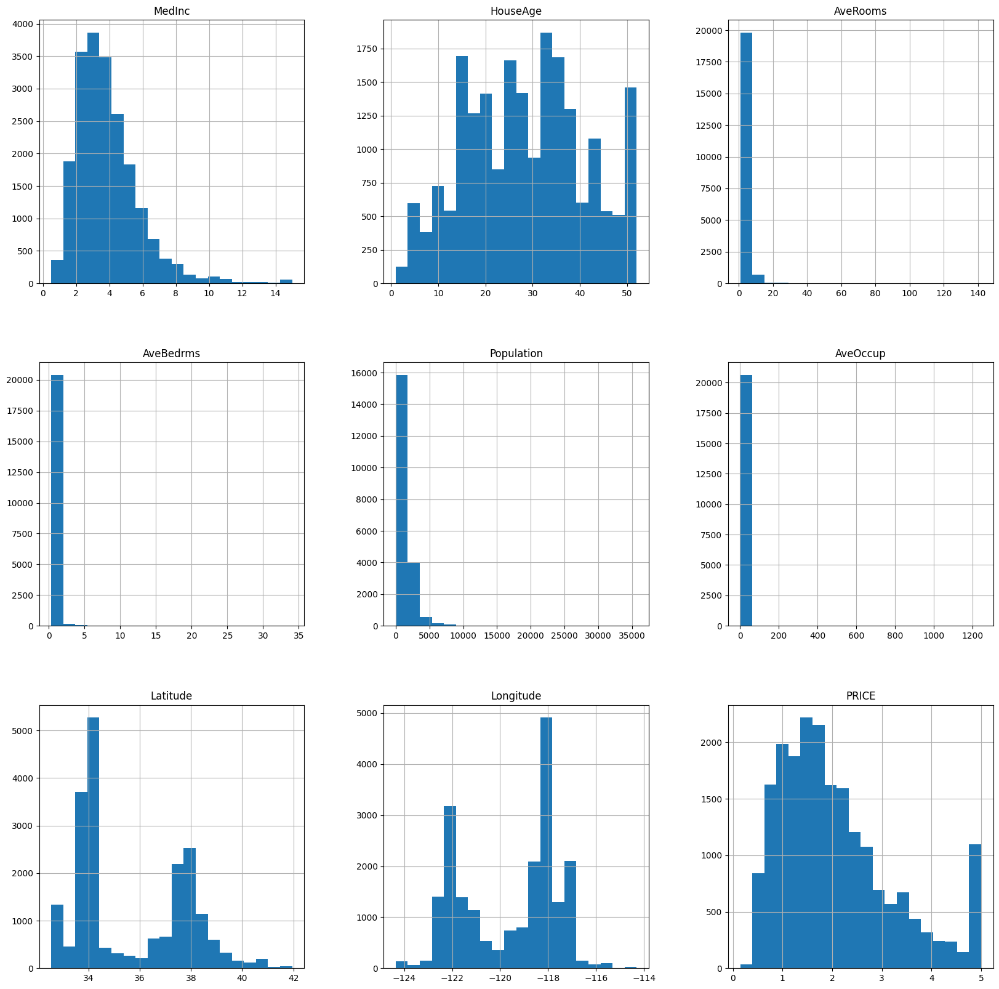

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

boston_df.hist(figsize=(20,20), bins=20)
plt.show()

* 히스토그램에서 얻을 수 있는 정보는 어떤 것이 있을까요?

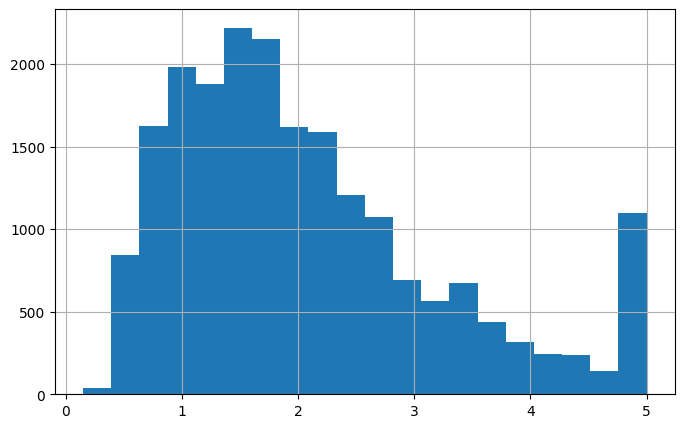

In [24]:
boston_df['PRICE'].hist(figsize=(8,5), bins = 20)
plt.show()

In [25]:
boston_df[boston_df['PRICE'] >= 5]

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,PRICE
89,1.2434,52.0,2.929412,0.917647,396.0,4.658824,37.80,-122.27,5.00001
459,1.1696,52.0,2.436000,0.944000,1349.0,5.396000,37.87,-122.25,5.00001
493,7.8521,52.0,7.794393,1.051402,517.0,2.415888,37.86,-122.24,5.00001
494,9.3959,52.0,7.512097,0.955645,1366.0,2.754032,37.85,-122.24,5.00001
509,7.8772,52.0,8.282548,1.049861,947.0,2.623269,37.83,-122.23,5.00001
...,...,...,...,...,...,...,...,...,...
20422,5.1457,35.0,6.958333,1.217593,576.0,2.666667,34.14,-118.90,5.00001
20426,10.0472,11.0,9.890756,1.159664,415.0,3.487395,34.18,-118.69,5.00001
20427,8.6499,4.0,7.236059,1.032528,5495.0,2.553439,34.19,-118.80,5.00001
20436,12.5420,10.0,9.873315,1.102426,1179.0,3.177898,34.21,-118.69,5.00001


아, 500,000달러 이상의 집들은 다 5.000001로 통일시킨 건 아닐까?

이렇게 각 변수의 특징을 살펴본 후에는 변수와 변수 사이의 관계, 특히나 target과 각 변수 사이의 관계를 살펴봅니다.

Text(0, 0.5, 'PRICE')

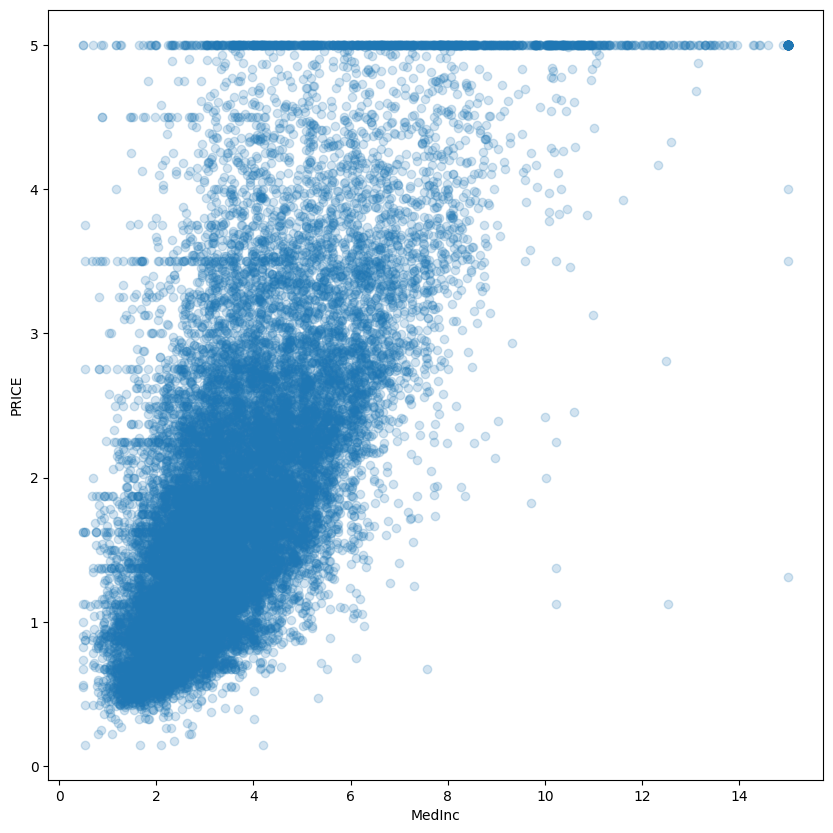

In [28]:
plt.figure(figsize=(10,10))

plt.scatter(boston_df['MedInc'], boston_df['PRICE'], alpha=0.2)

plt.xlabel('MedInc')
plt.ylabel('PRICE')

<Figure size 3000x3000 with 0 Axes>

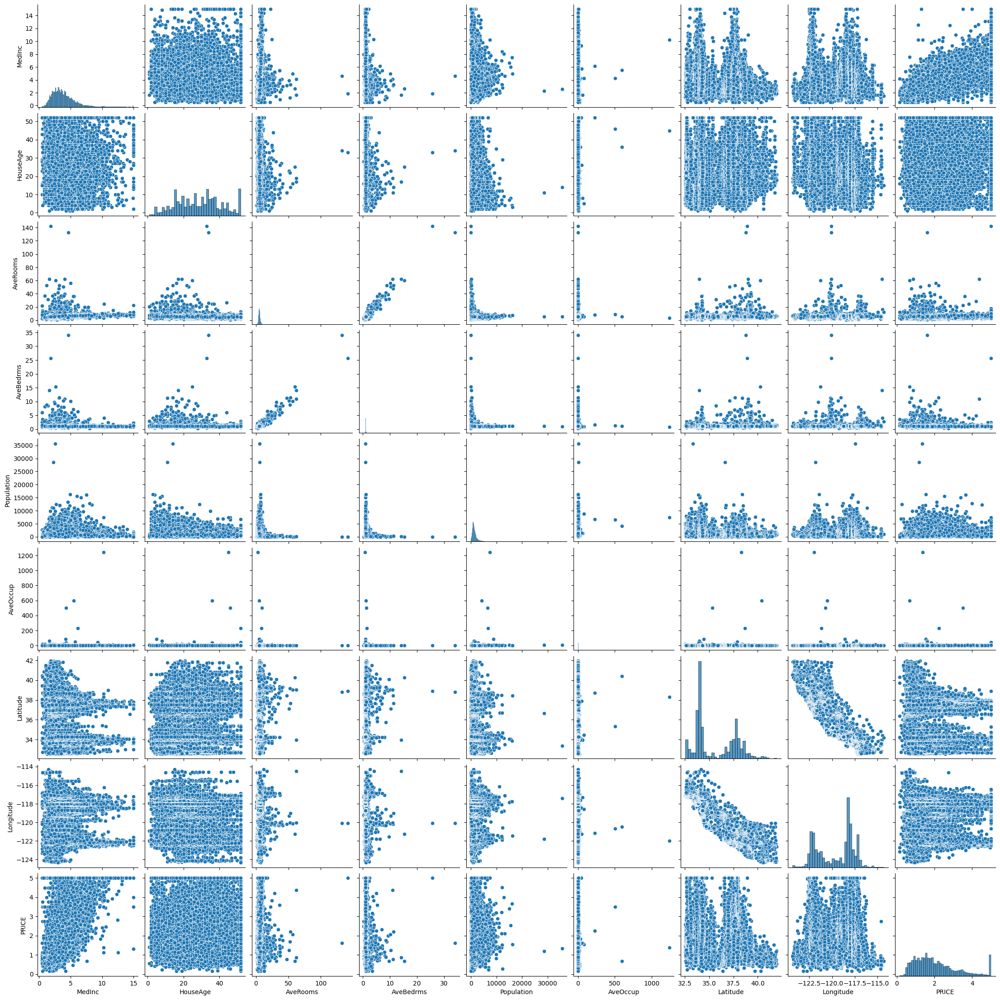

In [31]:
plt.figure(figsize=(30,30))
sns.pairplot(boston_df)
plt.show()

# 각 feature 간에 상관관계를 한 눈에 파악하기 좋음
# 대각선으로 대칭
# 같은 특성 간에 상관관계는 의미가 없으므로 histogram이 출력

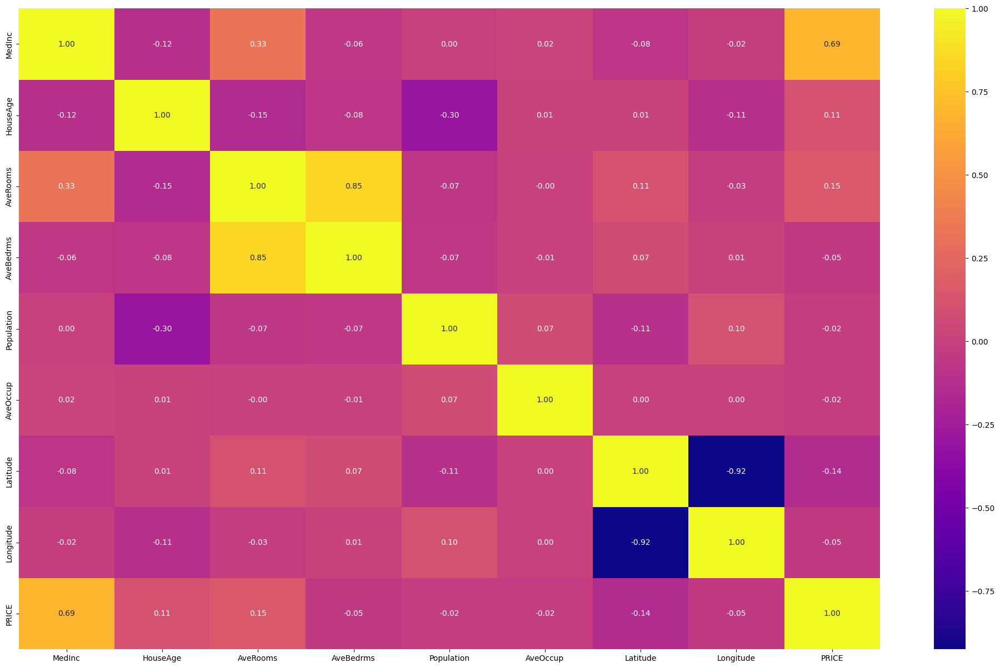

In [46]:
# Matplotlib를 사용하여 플롯 크기 조정
plt.figure(figsize=(25, 15))

# 히트맵 생성
sns.heatmap(boston_df.corr(), annot=True, cmap='plasma', fmt=".2f")

# 플롯 표시
plt.show()

* 위도와 경도는 어떻게 살펴보는게 좋을까요?

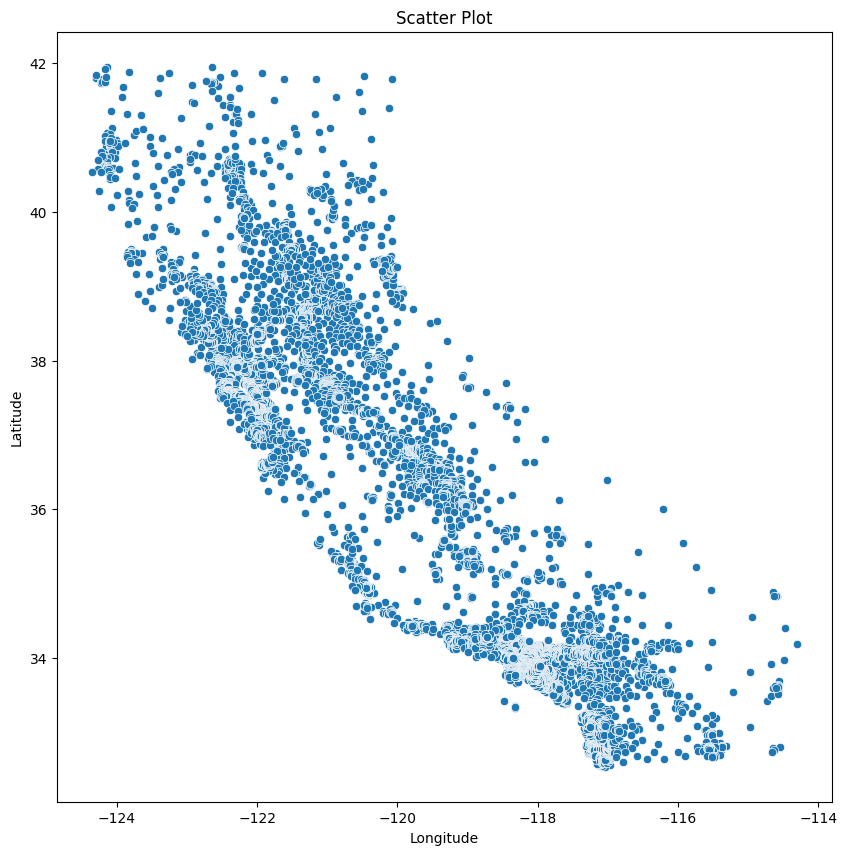

In [56]:
# 방법 1: 산점도를 이용해서

plt.figure(figsize=(10,10))

#산점도
sns.scatterplot(x=boston_df['Longitude'],y=boston_df['Latitude'])

#이름
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Scatter Plot')

plt.show()

In [ ]:
# 방법 2 : 산점도를 이용해서 대략적인 위치 + 집값 정보까지 함께 표현하기

plt.figure(figsize=(8,8))



In [58]:
import folium
import numpy as np
import pandas as pd

# 지도 생성
m = folium.Map(location=[42.3601, -71.0589], zoom_start=12)  # 좌표와 줌 레벨을 설정

# 데이터 생성 (예: x와 y는 두 변수의 데이터를 나타내는 NumPy 배열)
x=boston_df['Longitude']
y=boston_df['Latitude']

# 산점도 그리기
for i in range(len(x)):
    folium.CircleMarker(
        location=[x[i], y[i]],
        radius=5,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        tooltip=f'Data Point {i + 1}'
    ).add_to(m)

# 지도를 HTML 파일로 저장 (선택 사항)
m.save('scatter_map.html')

# 지도 표시
m

### 3. 전처리 및 정제(Preprocessing and Cleaning)

데이터 전처리: 데이터를 머신러닝 알고리즘에 넣기 위해 준비하는 과정
- 목표: 학습을 잘 하는 것   
- (1) 무사히 학습을 잘 끝내는 것 (모델의 성능을 포함하여)
- (2) 학습속도가 빨라야 함

사실 지금의 데이터는 sklearn측에서 일차적으로 전처리를 끝낸 데이터이기 때문에 크게 전처리를 하지 않아도 괜찮습니다. 하지만 여러 공공데이터나 직접 데이터를 수집했을 경우에는 다양한 전처리 과정이 필수입니다!

#### 1. 결측치

In [60]:
# 각 feature의 결측치 개수를 확인
boston_df.isnull().sum()

MedInc        0
HouseAge      0
AveRooms      0
AveBedrms     0
Population    0
AveOccup      0
Latitude      0
Longitude     0
PRICE         0
dtype: int64

#### Scaling

[문제]
1. 스케일이 작은 feature가 상대적으로 가까워보임
2. 최적화 학습문제(학습속도문제)



##### Sklearn이용 scaling
- https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html
- https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html

스케일링 시 유의할 점!
- 학습데이터 세트와 테스트 데이터 세트로 나누어진 경우, 학습 데이터 세트로 fit()이 적용된 스케일링 기준 정보를 그대로 테스트 데이터 세트에 적용해야 합니다. 그렇지 않고 테스트 데이터로 다시 새로운 스케일링 기준을 만들면 학습데이터와 테스트 데이터의 스케일링 기준 정보가 서로 달라지기 때문에 올바른 예측을 하지 못합니다.

따라서, 학습데이터와 테스트 데이터의 fit(), transform(), fit_transform()을 이용해 스케일링을 한다면

1. 가능하다면 전체 데이터의 스케일링 변호나을 적용한 뒤 학습과 테스트 데이터 분리
2. 1번이 힘들다면, 테스트 변환시에는 오직 transform()만 적용하기!    
   학습데이터로 fit()이된 scaler 객체를 그대로 이용하는 것이 포인트!

In [61]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

In [67]:
x_df = boston_df.iloc[:, :-1]

In [68]:
# scaler instance
std_scaler = StandardScaler()

# fitting
std_scaler.fit(boston_df.iloc[:, :-1])

StandardScaler()

In [72]:
# 스케일링 실행
x_scaled= std_scaler.transform(boston_df.iloc[:, :-1])
x_scaled

array([[ 2.34476576,  0.98214266,  0.62855945, ..., -0.04959654,
         1.05254828, -1.32783522],
       [ 2.33223796, -0.60701891,  0.32704136, ..., -0.09251223,
         1.04318455, -1.32284391],
       [ 1.7826994 ,  1.85618152,  1.15562047, ..., -0.02584253,
         1.03850269, -1.33282653],
       ...,
       [-1.14259331, -0.92485123, -0.09031802, ..., -0.0717345 ,
         1.77823747, -0.8237132 ],
       [-1.05458292, -0.84539315, -0.04021111, ..., -0.09122515,
         1.77823747, -0.87362627],
       [-0.78012947, -1.00430931, -0.07044252, ..., -0.04368215,
         1.75014627, -0.83369581]])

In [73]:
pd.DataFrame(x_scaled).describe()

,0,1,2,3,4,5,6,7
count,2.064000e+04,2.064000e+04,2.064000e+04,2.064000e+04,2.064000e+04,2.064000e+04,2.064000e+04,2.064000e+04
mean,6.609700e-17,5.508083e-18,6.609700e-17,-1.060306e-16,-1.101617e-17,3.442552e-18,-1.079584e-15,-8.526513e-15
std,1.000024e+00,1.000024e+00,1.000024e+00,1.000024e+00,1.000024e+00,1.000024e+00,1.000024e+00,1.000024e+00
min,-1.774299e+00,-2.196180e+00,-1.852319e+00,-1.610768e+00,-1.256123e+00,-2.290000e-01,-1.447568e+00,-2.385992e+00
25%,-6.881186e-01,-8.453931e-01,-3.994496e-01,-1.911716e-01,-5.638089e-01,-6.171062e-02,-7.967887e-01,-1.113209e+00
50%,-1.767951e-01,2.864572e-02,-8.078489e-02,-1.010650e-01,-2.291318e-01,-2.431585e-02,-6.422871e-01,5.389137e-01
75%,4.593063e-01,6.643103e-01,2.519615e-01,6.015869e-03,2.644949e-01,2.037453e-02,9.729566e-01,7.784964e-01
max,5.858286e+00,1.856182e+00,5.516324e+01,6.957171e+01,3.025033e+01,1.194191e+02,2.958068e+00,2.625280e+00


In [76]:
# minmax 스케일러 인스턴스 생성
mm_scaled = MinMaxScaler()

# xdata에 피팅 및 스케일링
mm_scaled.fit(boston_df.iloc[:, :-1])
x_mm_scaled = mm_scaled.transform(boston_df.iloc[:, :-1])
x_mm_scaled

array([[0.53966842, 0.78431373, 0.0435123 , ..., 0.00149943, 0.5674814 ,
        0.21115538],
       [0.53802706, 0.39215686, 0.03822395, ..., 0.00114074, 0.565356  ,
        0.21215139],
       [0.46602805, 1.        , 0.05275646, ..., 0.00169796, 0.5642933 ,
        0.21015936],
       ...,
       [0.08276438, 0.31372549, 0.03090386, ..., 0.0013144 , 0.73219979,
        0.31175299],
       [0.09429525, 0.33333333, 0.03178269, ..., 0.0011515 , 0.73219979,
        0.30179283],
       [0.13025338, 0.29411765, 0.03125246, ..., 0.00154886, 0.72582359,
        0.30976096]])

In [77]:
pd.DataFrame(x_mm_scaled).describe()

,0,1,2,3,4,5,6,7
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,0.232464,0.541951,0.032488,0.022629,0.039869,0.001914,0.328572,0.476125
std,0.131020,0.246776,0.017539,0.014049,0.031740,0.008358,0.226988,0.199555
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.142308,0.333333,0.025482,0.019943,0.021974,0.001398,0.147715,0.253984
50%,0.209301,0.549020,0.031071,0.021209,0.032596,0.001711,0.182784,0.583665
75%,0.292641,0.705882,0.036907,0.022713,0.048264,0.002084,0.549416,0.631474
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


#### y_data_ preprocessing: Encoding

학습 데이터의 특성들은 수치값 뿐만 아니라 ‘크다’, ‘중간’, ‘작다’ 또는 ‘여자’, ‘남자’와 같은 범주값도 존재합니다.

먼저 범주형 값을 처리하기 위해서는 이 범주형 값을 수치값으로 변환해야 합니다

이때, 1등급, 2등급, 3등급 처럼 의미에 대소관계, 순위적 연속성 등이 있으면 라벨 인코딩으로 처리를 합니다.

성별, 과일 등 순위관계가 없으면 각각을 벡터로 치환하는 원핫인코딩을 진행합니다.

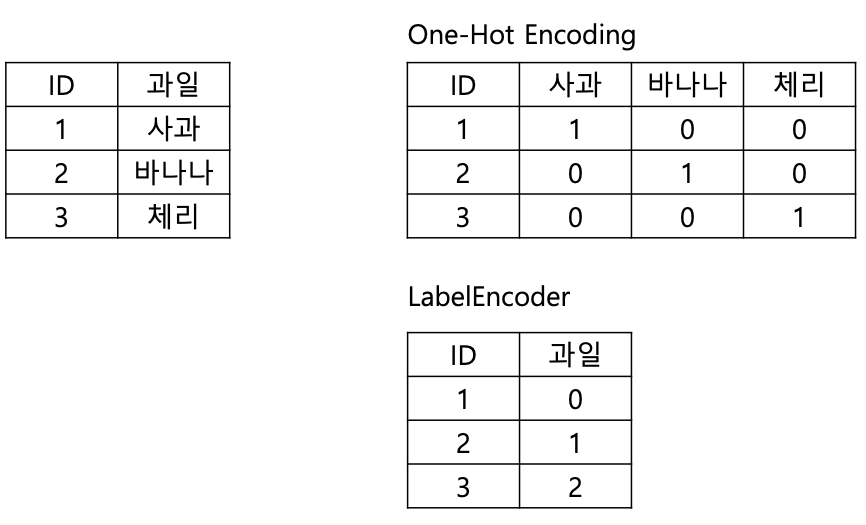

##### 라벨 인코더 예제

In [78]:
# example

from sklearn.preprocessing import LabelEncoder

lb_encoder = LabelEncoder()
lb_encoder.fit(["paris","paris","tokyo", "amsterdam"])
lb_encoder.classes_

array(['amsterdam', 'paris', 'tokyo'], dtype='<U9')

In [79]:
lb_encoder.transform(["tokyo", "tokyo", "paris"])

array([2, 2, 1])

In [80]:
# 거꾸로 라벨
list(lb_encoder.inverse_transform([2, 2, 1]))

['tokyo', 'tokyo', 'paris']

##### 원-핫 인코더 실행하기

In [82]:
# X data
import pandas as pd
df = pd.DataFrame([
    [2,1,'male','A',3],
    [3,2,'female','C',5],
    [3,4,'male','B',7],
    [5,5,'female','A',10],
    [7,5,'female','B',12],
    [2,5,'male','A',7],
    [9,2,'male','C',13]
], columns=['hours', 'attendance', 'sex', 'cate', 'score'])
df

,hours,attendance,sex,cate,score
0,2,1,male,A,3
1,3,2,female,C,5
2,3,4,male,B,7
3,5,5,female,A,10
4,7,5,female,B,12
5,2,5,male,A,7
6,9,2,male,C,13


In [85]:
df[['sex']]

,sex
0,male
1,female
2,male
3,female
4,female
5,male
6,male


In [91]:
from sklearn.preprocessing import OneHotEncoder

oh_encoder = OneHotEncoder(sparse=False)

oh_encoder.fit(df[['sex']])
print(oh_encoder.transform(df[['sex']]))

[[0. 1.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [0. 1.]]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


In [92]:
oh_encoder.categories_

[array(['female', 'male'], dtype=object)]

In [93]:
df = pd.concat([df, pd.DataFrame(oh_encoder.transform(df[['sex']]), columns =oh_encoder.categories_[0])], axis=1 )

In [94]:
df

,hours,attendance,sex,cate,score,female,male
0,2,1,male,A,3,0.0,1.0
1,3,2,female,C,5,1.0,0.0
2,3,4,male,B,7,0.0,1.0
3,5,5,female,A,10,1.0,0.0
4,7,5,female,B,12,1.0,0.0
5,2,5,male,A,7,0.0,1.0
6,9,2,male,C,13,0.0,1.0


In [95]:
# 방법 2 : get_dummies

df = pd.DataFrame([
     [2,1,'male','A',3],
    [3,2,'female','C',5],
    [3,4,'male','B',7],
    [5,5,'female','A',10],
    [7,5,'female','B',12],
    [2,5,'male','A',7],
    [9,2,'male','C',13]
], columns=['hours','attendance','sex','cate','score'])

df

,hours,attendance,sex,cate,score
0,2,1,male,A,3
1,3,2,female,C,5
2,3,4,male,B,7
3,5,5,female,A,10
4,7,5,female,B,12
5,2,5,male,A,7
6,9,2,male,C,13


In [96]:
sex = pd.get_dummies(df['sex'], prefix='sex')
df = pd.concat([df, sex], axis=1)
df.head()

,hours,attendance,sex,cate,score,sex_female,sex_male
0,2,1,male,A,3,0,1
1,3,2,female,C,5,1,0
2,3,4,male,B,7,0,1
3,5,5,female,A,10,1,0
4,7,5,female,B,12,1,0


df_housing은 카테고리형 데이터가 없어서 이부분은 진행하지 않습니다.







### 4. 모델링 및 훈련(Modeling and Training)

학습에 들어가기 전, 학습데이터와 테스트 데이터를 분리하겠습니다.    
https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html

In [98]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(x_scaled, y_data)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((15480, 8), (5160, 8), (15480,), (5160,))

In [100]:
from sklearn.linear_model import LinearRegression

# model instance
LR_model=LinearRegression()

# model training
LR_model.fit(X_train, y_train)

# model predict
y_pred = LR_model.predict(X_train)
y_pred

array([1.03153393, 0.65390345, 1.7569902 , ..., 1.51619705, 1.40847113,
       2.18384992])

In [102]:
# 성능평가지표
from sklearn.metrics import r2_score
r2_score(y_train, y_pred)

0.6085901469733468

In [111]:
# test data _ R2 score
y_test_pred = LR_model.predict(X_test)
r2_score(y_test, y_test_pred)

0.5985397622237384

In [113]:
from sklearn.metrics import mean_squared_error

# train data MSE
train_mse = mean_squared_error(y_pred, y_train, squared=False)

# test data MSE
test_mse= mean_squared_error(y_test_pred, y_test, squared=False)

train_mse, test_mse

(0.7217964668820097, 0.7315346836205552)

In [115]:
LR_model.coef_, LR_model.intercept_

(array([ 0.82072465,  0.11479431, -0.24482562,  0.27841952, -0.00653627,
        -0.03486095, -0.89662492, -0.87075932]),
 2.065072174552661)

모델의 성능을 높이고 싶다면 어떻게 해야 할까?

1. 모델 파라미터를 수정하거나
2. 데이터 수집이나 전처리 과정을 수정하거나
3. 또 다른 모델 알고리즘을 실험하거나

다양한 방법이 있습니다. 우리는 다른 모델을 배우기 전이므로 모델 파라미터 수정부터 배워봅시다.

### 5. 교차검증

우선 교차 검증부터 해봅시다. 교차검증은 sklearn에 `cross_val_score()` 함수를 이용하여 간편하게 진행할 수 있습니다.

In [116]:
from sklearn.model_selection import cross_val_score

LR_model = LinearRegression()

# 성능지표 r2, 교차검증세트는 3개
# cv=3은 3-폴드 교차 검증을 수행하겠다는 의미입니다. 데이터를 3개의 폴드로 나누어 세 번의 검증을 수행합니다.
scores = cross_val_score(LR_model, X_train, y_train, scoring='r2', cv=3)

print("교차 검증별 정확도:", np.round(scores, 4)) # 소수점 4번째 자리에서 반올림
print("평균 검증 정확도:", np.round(np.mean(scores),4))

교차 검증별 정확도: [0.594  0.6336 0.5843]
평균 검증 정확도: 0.604


이번에는 최적 하이퍼 파라미터 튜닝과 교차검증을 한번에 해봅시다.   
여러 탐색 함수들이 있지만 GridSearchCV를 사용해보겠습니다.

GridSearchCV는 입력한 파라미터의 조합 중에서 최고 성능을 가지는 파라미터 조합을 찾아주는 함수입니다.   
우선 탐색하고자 하는 파라미터 집합을 만듭니다.

사실 선형회귀는 선택할 파라미터 조합이 매우 한정적이지만, GridSearchCV의 사용법을 익히기 위해 작성해보겠습니다.

In [127]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge, Lasso

LR_model = LinearRegression()

grid_params = {
    #'alpha': [0.1, 1.0, 10.0],  # Ridge 모델의 하이퍼파라미터
    'fit_intercept' : [True, False],
    # 'normalize' : [True, False]
}

grid_search_linear = GridSearchCV(LR_model, param_grid = grid_params, cv=3, refit=True, scoring='r2')
# refit : True가 디폴트, True이면 가장 좋은 파라미터 설정으로 학습시켜서 모델 반환

grid_search_linear.fit(X_train, y_train)
print("최적 하이퍼파라미터:", grid_search_linear.best_params_)

최적 하이퍼파라미터: {'fit_intercept': True}
